Scroll to the last-cell for the comparison of the aspect ratios from the two algorithms

- The values of 0 in Algo 1 correspond to the values set by us - when the focal length
estimation comes out to be infinity

- Both these algorithms give the correct aspect ratio 10/3 i.e 3.33 for very few seaweed farms

- Therefore the recommendation is that image to be captured with the drone - if it is more carefully done, the algorithm might be able to do better results

In [2]:
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.image as mpimg
from matplotlib import path
import cv2

from skimage import io
from skimage import transform
#from skimage import segmentation
from skimage import filters
#from skimage import morphology
from skimage import measure
from skimage import util

from sklearn import cluster

from scipy.spatial import ConvexHull

In [3]:
class ImageDetection:
    
    def __init__(self,imgFile,farmWidth=3.0):
        self.imgFile = imgFile
        self.farmWidth = farmWidth
        
    def read(self,invert=False):
        img = io.imread(self.imgFile,as_gray=True)
        img = util.img_as_float(img)
        if invert:
            img = util.invert(img)    
        self.img = img
        self.img_x, self.img_y = img.shape
        return img
    
    def readRGB(self):
        self.rgbimg = io.imread(self.imgFile)
        return self.rgbimg
        
    def rescale(self,img,scale):
        if self.img is not None:
            self.scale = np.float(scale)
            self.img_rs = transform.rescale(self.img,self.scale,multichannel=False)
            return self.img_rs
            
    def plotImg(self,img,title=None,cmap='gray',figsize=(15,15)):
        fig, ax = plt.subplots(1,1,figsize=figsize)
        ax.axis('off')
        ax.imshow(img,cmap=cmap)
        if title:
            ax.set_title(title,fontsize=20)
        plt.show()

    def plotHist(self,img,title=None):
        fig, ax = plt.subplots(1, 1)
        ax.hist(img.ravel(), bins=32, range=[0.0, 1.2])
        ax.set_xlim(0.0,1.2);
        if title:
            ax.set_title(title,fontsize=20)
        plt.show()
        
    def plotCoords(self,coords,s=1,c='r',fmt='ro'):
        fig, ax = plt.subplots(1,1,figsize=(10,10))
        ax.plot(coords[:,0],coords[:,1],fmt)
        plt.show()        
        
    def gaussFilter(self,img,sigma=1):
        return filters.gaussian(img,sigma)
    
    def getLocalThresh(self,img, block_size=101, offset=-0.05):
        return filters.threshold_local(img,block_size=block_size, offset=offset) 
    
    def binarizeThresh(self,img,thresh):
        return img>thresh
    
    def blurThicken(self,img,sigma=1):
        img_blur = self.gaussFilter(img,sigma)
        return self.binarizeThresh(img_blur,0)
    
    def applyBinMask(self,img,binMask):
        return np.multiply(img,binMask)
    
    def getThickBinMask(self,img,initSigma=1,block_size=101,offset=-0.05,finalSigma=1):
        img_gauss = self.gaussFilter(img,sigma=initSigma)
        img_thresh = self.getLocalThresh(img_gauss,block_size=block_size,offset=offset)
        img_bin = self.binarizeThresh(img_gauss,img_thresh)
        img_bin_thick = imgD.blurThicken(img_bin,sigma=finalSigma)
        return img_bin_thick
    
    def getCoords_Img(self,img):
        numRow, numCol = img.shape
        ygrid, xgrid = np.mgrid[:numRow, :numCol]
        coords = np.vstack((xgrid.ravel(), ygrid.ravel())).T
        return coords
    
    def getCoords_binImg(self,img):
        a = np.ones(img.shape)
        x_i = np.linspace(0,img.shape[0]-1,img.shape[0]).astype('uint')
        y_i = np.linspace(0,img.shape[1]-1,img.shape[1]).astype('uint')
        x_mask = np.multiply(a.T,x_i).T
        y_mask = np.multiply(a,y_i)
        x_coords = np.multiply(a,x_mask)
        y_coords = np.multiply(a,y_mask)
        all_coords = np.vstack((x_coords.flatten(),y_coords.flatten())).T.astype('uint')
        res = all_coords[img.flatten().astype('uint8')==1]
        return res
    
    def applyDBSCAN(self,coords,eps=10, min_samples=30):
        dbscan = cluster.DBSCAN(eps=eps, min_samples=min_samples)
        dbscan.fit(coords)
        predictions = dbscan.labels_
        return predictions
    
    def getGroupNums(self,groups,include0=True):
        if include0:
            return np.unique(groups)
        else:
            all_groups = np.unique(groups)
            index = np.where(all_groups == 1)
            return all_groups[index[0][0]:]
    
    def applyLabels_binImg(self,img,coords,labels):
        label_mask = np.zeros(img.shape).astype('uint')
        for i in range(len(coords)):
            row,col = coords[i]
            label_mask[row][col]=labels[i]
        return label_mask
    
    def upscale_binMask(self,img,rs_mask,scale):
        rs_mask_upscale = transform.rescale(rs_mask,1.0/scale,multichannel=False)
        full_mask = np.zeros(img.shape)
        full_mask[:rs_mask_upscale.shape[0],:rs_mask_upscale.shape[1]] = rs_mask_upscale
        return full_mask
    
    def applyConvexHull_Groups(self,coords,groups):
        groupNums = np.unique(groups)

        groupCoords = []
        groupHulls = []
        #img_rs_groups = []
        groupVertices = []

        for groupNum in groupNums:
            thisCoords = []
            for i in range(len(coords)):
                if groups[i]==groupNum:
                    thisCoords.append(coords[i])
            groupCoords.append(np.array(thisCoords))
            thisHull = ConvexHull(thisCoords)
            groupHulls.append(thisHull)
            #thisImg = np.multiply(img, img_groups==groupNum)
            #img_rs_groups.append(thisImg)
            thisVertices = []
            for vertex in thisHull.vertices:
                thisVertices.append([thisCoords[vertex][1],thisCoords[vertex][0]])
            groupVertices.append(np.array(thisVertices))
            
        return groupCoords,groupHulls,groupVertices
    
    def getImg_GroupMask(self,img,img_groups,groupNum):
        return np.multiply(img, img_groups==groupNum)    
    
    def plotRGBImg_GroupsRS(self,rgbimg,groups,groupNums,groupVertices,scale,
                            fmt='k-',linewidth=1,annotate=True):
        fig, ax = plt.subplots(1,1,figsize=(15, 15))
        ax.axis('off')
        ax.imshow(rgbimg)
        for groupNum in groupNums:
            ax.fill(groupVertices[groupNum][:,0]/scale,
                    groupVertices[groupNum][:,1]/scale,
                    fmt,linewidth=linewidth,fill=False)
            if annotate:
                ax.annotate(groupNum,xy=(groupVertices[groupNum][0][0]/scale,
                                         groupVertices[groupNum][0][1]/scale))
        plt.show()        
         
    def getGroupDetails(self,img,
                        initSigma=1,block_size=101,offset=-0.05,finalSigma=1,
                        eps=10,min_samples=30):
        img_bin_thick = self.getThickBinMask(img,initSigma=initSigma,
                                             block_size=block_size,
                                             offset=offset,
                                             finalSigma=finalSigma)
        coords = self.getCoords_binImg(img_bin_thick)
        groups = self.applyDBSCAN(coords,
                                  eps=eps,
                                  min_samples=min_samples)
        groupCoords,groupHulls,groupVertices = self.applyConvexHull_Groups(coords,groups)
        groupLabel_Mask = self.applyLabels_binImg(img,coords,groups)
        return groups,groupCoords,groupHulls,groupVertices,groupLabel_Mask

    
    def getMaskSubImg(self,img,scale,groupVertices,groupNum):
        scaledVertices = np.array(groupVertices[groupNum])/scale
        groupPath = path.Path(scaledVertices,closed=False)
        coords = self.getCoords_Img(img)
        mask = groupPath.contains_points(coords)
        mask = mask.reshape(img.shape)
        return mask
        
    
    def getSubImg(self,img,scale,groupVertices,groupNum,applyMask=True):
        min_x = int(np.min(groupVertices[groupNum][:,0])/scale)
        max_x = int(np.max(groupVertices[groupNum][:,0])/scale)
        min_y = int(np.min(groupVertices[groupNum][:,1])/scale)
        max_y = int(np.max(groupVertices[groupNum][:,1])/scale)
        if applyMask:
            mask = self.getMaskSubImg(img,scale,groupVertices,groupNum)
            masked_img = self.applyBinMask(img,mask)
            subimg = masked_img[min_y:max_y,min_x:max_x]
        else:
            subimg = img[min_y:max_y,min_x:max_x]
        return subimg
    
    def fitLine_imgBin(self,img,coords,plot=True):
        if len(coords)==0:
            return 0,0
        
        model = measure.LineModelND()
        model.estimate(coords)

        line_x = np.arange(0, img.shape[0])
        line_y = model.predict_y(line_x)

        coeff = (line_y[-1]-line_y[0])/(line_x[-1]-line_x[0])
        intercept = model.predict_y([0])
        
        if plot:
            fig, ax = plt.subplots(1,1,figsize=(10,10))
            ax.plot(coords[:,0],coords[:,1],'ko')
            ax.plot(line_x,line_y,'r-',linewidth=4)
            plt.show()        
        
        return coeff,intercept
    
    def rotateImg(self,img,coeff):
        return transform.rotate(img,-np.degrees(np.arctan(coeff)),resize=True)
    
    def rotateSubImg(self,img,
                     plotFit=True,
                    initSigma=1,block_size=101,offset=-0.05,finalSigma=1):
        img_bin_thick = self.getThickBinMask(img,
                                             initSigma=initSigma,
                                             block_size=block_size,
                                             offset=offset,
                                             finalSigma=finalSigma)
        img_coords = self.getCoords_binImg(img_bin_thick)
        coeff,intercept = self.fitLine_imgBin(img_bin_thick,img_coords,plot=plotFit)
        return self.rotateImg(img,coeff)
        
        
    
    def cropMask(self,img,mask):
        x_i = np.argmax(mask,axis=0)
        x_inz = np.nonzero(x_i)
        y_i = np.argmax(mask,axis=1)
        y_inz = np.nonzero(y_i)
        if ((len(x_inz[0])==0 or len(y_inz[0])==0)):
            return np.array([[0]])
        min_x = x_inz[0][0]
        max_x = x_inz[0][-1]
        img_w = mask.shape[1]
        min_y = y_inz[0][0]
        max_y = y_inz[0][-1]
        img_h = mask.shape[0]
        crops = ((min_y,img_h-max_y-1),(min_x,img_w-max_x-1))
        return util.crop(img,crops)
    
    def cropSubImg(self,img,sigma=3,thresh=0.7):
        img_gauss = self.gaussFilter(img,sigma=sigma)
        img_bin = self.binarizeThresh(img_gauss,thresh=thresh)
        return self.cropMask(img,img_bin)   
    
    def getAspectRatio(self,img):
        aspectRatio = np.float(img.shape[0]/img.shape[1])
        if aspectRatio == 0:
            aspectRatio = 1
        return aspectRatio
    
    def getAreaRatio(self,img,
                     initSigma=1,block_size=101,offset=-0.05,finalSigma=1):
        img_bin_thick = self.getThickBinMask(img,
                                    initSigma=initSigma,
                                    block_size=block_size,
                                    offset=offset,
                                    finalSigma=finalSigma)
        actualArea = np.sum(img_bin_thick)
        imgArea = img.shape[0]*img.shape[1]
        return np.float(actualArea/imgArea)
    
    def getSizeRatio(self,img,subimg):
        img_x, img_y = img.shape
        subimg_x, subimg_y = subimg.shape
        return (subimg_x*subimg_y)/(img_x*img_y)
    
    def check_img_is_farm(self,img):
        sizeRatio = self.getSizeRatio(self.img,img)
        isNormalSize = sizeRatio > 0.001 and sizeRatio < 0.025
        aspectRatio = self.getAspectRatio(img)
        isRect = aspectRatio>2.5 or aspectRatio<1.0/2.5
        isFarm = isNormalSize and isRect
        return isFarm
    
    def check_farm_is_full(self,img):
        if self.check_img_is_farm(img):
            return self.getAreaRatio(img)>0.5
        return False
    
    def get_farm_length(self,img):
        if self.check_img_is_farm(img):
            aspectRatio = self.getAspectRatio(img)
            if aspectRatio>1:
                farmLength = self.farmWidth*aspectRatio
            else:
                farmLength = self.farmWidth/aspectRatio
            return farmLength
        return 0.0
    
    def get_farm_area(self,img):
        if self.check_img_is_farm(img):
            return self.farmWidth*self.get_farm_length(img)
        return 0.0
    
    def determineOptimumThresh_Crop(self,img,sigma=3):
        a = np.linspace(0.0,100,21)
        b = ((-1)**(a%2))*a/4
        thresholds = 0.75+b/100
        threshs = []
        metric = []
        #thresholds = np.linspace(0.5,1.0,20)
        for thresh in thresholds:
            threshs.append(thresh)
            subimg = self.cropSubImg(img,sigma=sigma,thresh=thresh)
            areaRatio = self.getAreaRatio(subimg)
            metric.append(subimg.shape[0]*subimg.shape[1]*areaRatio)
        optThresh = threshs[np.argmax(metric)]
        return optThresh
        

    

/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/3209966163.py:22: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  self.scale = np.float(scale)
/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/3209966163.py:23: FutureWarning: `multichannel` is a deprecated argument name for `rescale`. It will be removed in version 1.0. Please use `channel_axis` instead.
  self.img_rs = transform.rescale(self.img,self.scale,multichannel=False)


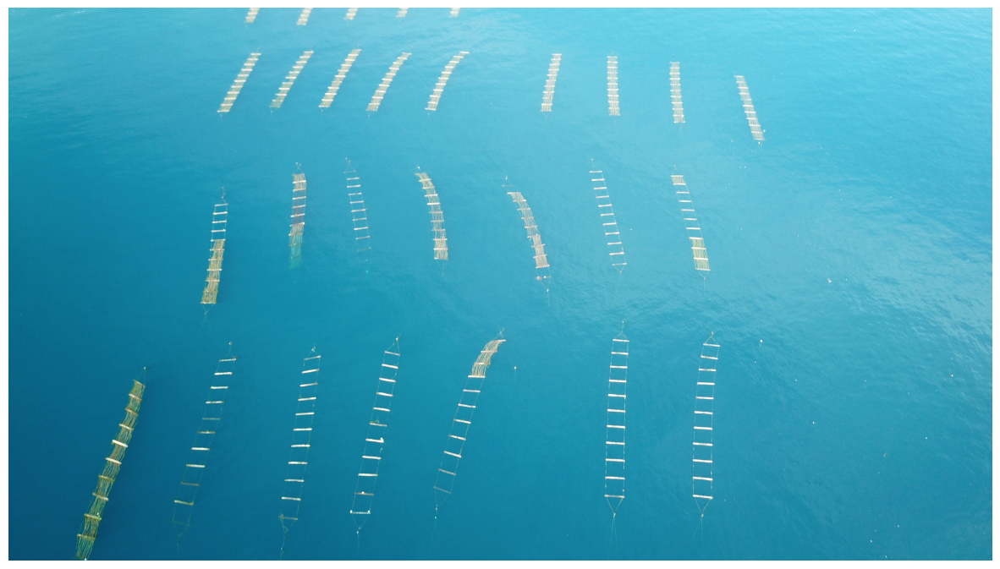

In [4]:
#imgFile = '001.png'
#imgFile = 'DJI_0003.JPG'
#imgFile = 'DJI_0008.JPG'
#imgFile = 'DJI_0016.JPG'
#imgFile = 'DJI_0039.JPG'
#imgFile = 'DJI_0075.JPG'
#imgFile = 'DJI_0076.JPG'
#imgFile = 'DJI_0093.JPG'
imgFile = imgFile = '/Users/praneeth/Downloads/Praneeth/Easy/Input/DJI_0076.JPG'
#imgFile = 'DJI_0190.JPG'

farmWidth = 3.0 # meters
tubenetPerMeter = 10 # meters

    

imgD = ImageDetection(imgFile,farmWidth)
img = imgD.read(invert=False)
imgrgb = imgD.readRGB()
scale = 1.0/4.0
img_rs = imgD.rescale(img,scale)
imgD.plotImg(imgrgb)

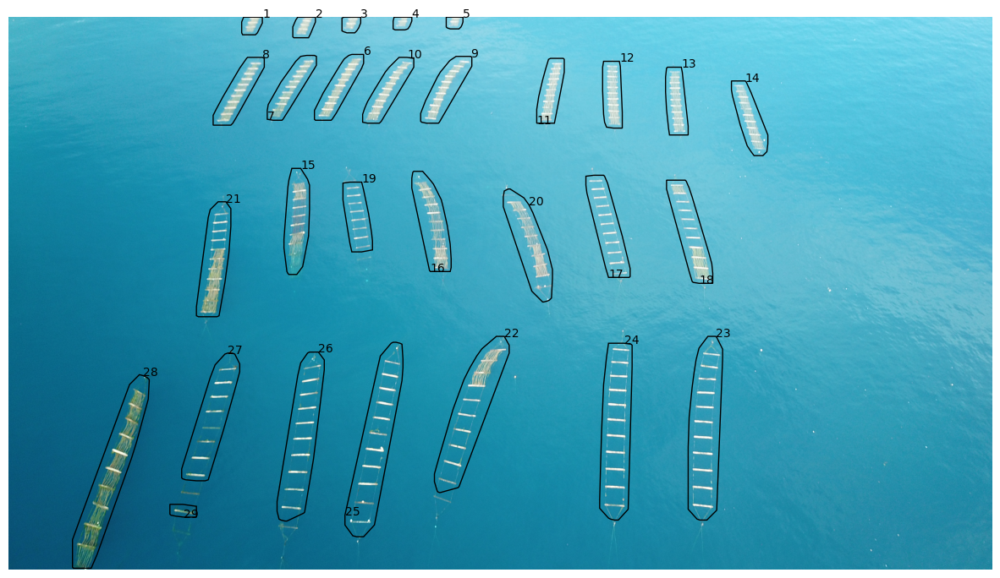

In [5]:
groups,groupCoords,groupHulls,groupVertices,groupLabel_Mask_rs = imgD.getGroupDetails(img_rs,
                                                                   initSigma=1,
                                                                   block_size=101,
                                                                   offset=-0.05,
                                                                   finalSigma=1,
                                                                   eps=10,
                                                                   min_samples=200)
groupNums = imgD.getGroupNums(groups,include0=True)
#groupNums = groupNums_all
#groupLabel_Mask = imgD.upscale_binMask(img,groupLabel_Mask_rs,scale)
imgD.plotRGBImg_GroupsRS(imgrgb,groups,groupNums[2:],groupVertices,scale,annotate=True)

In [6]:
#subImgs = []
aspectRatios = []
areaRatios = []
sizeRatios = []
isFarms = []
isFulls = []
farmLength = [] # meters
farmArea = [] # meter square
farmTubenet = [] # meter



for groupNum in groupNums:
    #subimg_mask = imgD.getImg_GroupMask(img,groupLabel_Mask,groupNum)
    subimg = imgD.getSubImg(img,scale,groupVertices,groupNum)
    subimg_rot = imgD.rotateSubImg(subimg,
                               plotFit=False,
                               initSigma=1,
                               block_size=101,
                               offset=-0.05,
                               finalSigma=1)
    thresh = imgD.determineOptimumThresh_Crop(subimg_rot)
    subimg_rot_crop = imgD.cropSubImg(subimg_rot,sigma=3,thresh=thresh)
    
    aspectRatio = imgD.getAspectRatio(subimg_rot_crop)
    areaRatio = imgD.getAreaRatio(subimg_rot_crop,
                                  initSigma=1,
                                  block_size=101,
                                  offset=-0.05,
                                  finalSigma=1)
    sizeRatio = imgD.getSizeRatio(img,subimg_rot_crop)
    isFarm = imgD.check_img_is_farm(subimg_rot_crop)
    isFull = imgD.check_farm_is_full(subimg_rot_crop)
    thisLength = imgD.get_farm_length(subimg_rot_crop)
    thisArea = farmWidth*thisLength
    thisTubenet = tubenetPerMeter*thisLength
    
    
    #subImgs.append(subimg)
    aspectRatios.append(aspectRatio)
    areaRatios.append(areaRatio)
    sizeRatios.append(sizeRatio)
    isFarms.append(isFarm)
    isFulls.append(isFull)
    farmLength.append(thisLength)
    farmArea.append(thisArea)
    farmTubenet.append(thisTubenet)
    
    print(groupNum,round(aspectRatio,2),round(areaRatio,2),
          round(sizeRatio,5),isFarm,isFull,round(thisLength,2),
          round(thisArea,2),round(thisTubenet,2))
    
print('Num Farms: ',np.sum(isFarms))
print('Num Full: ',np.sum(isFulls))   
print('Total Farm Length (m)',np.sum(farmLength))
print('Total Farm Area (m2)',np.sum(farmArea))
print('Total Tubenet Length (m)',np.sum(farmTubenet))

/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/3209966163.py:269: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  return np.float(actualArea/imgArea)
/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/3209966163.py:255: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  aspectRatio = np.float(img.shape[0]/img.shap

-1 1.0 0.0 0.0 False False 0.0 0.0 0.0
0 2.38 0.08 0.75581 False False 0.0 0.0 0.0
1 0.8 0.78 0.00076 False False 0.0 0.0 0.0
2 0.97 0.75 0.00081 False False 0.0 0.0 0.0
3 1.19 0.89 0.00061 False False 0.0 0.0 0.0
4 1.33 0.82 0.00043 False False 0.0 0.0 0.0
5 1.45 0.79 0.00036 False False 0.0 0.0 0.0
6 3.95 0.6 0.00288 True True 11.85 35.56 118.52
7 3.82 0.6 0.00285 True True 11.45 34.35 114.51
8 4.01 0.57 0.003 True True 12.04 36.11 120.37
9 3.4 0.58 0.00348 True True 10.19 30.56 101.88
10 3.62 0.61 0.00318 True True 10.85 32.56 108.54
11 3.03 0.77 0.00267 True True 9.1 27.3 91.01
12 3.08 0.76 0.00259 True True 9.24 27.72 92.41
13 3.19 0.71 0.00262 True True 9.56 28.67 95.58
14 3.49 0.71 0.00328 True True 10.47 31.4 104.67
15 4.8 0.6 0.00413 True True 14.39 43.16 143.86
16 3.99 0.56 0.00489 True True 11.97 35.91 119.71
17 4.63 0.48 0.00454 True False 13.88 41.65 138.83
18 4.8 0.53 0.00461 True True 14.39 43.16 143.87
19 2.9 0.53 0.00297 True True 8.69 26.06 86.88
20 4.23 0.6 0.006 Tru

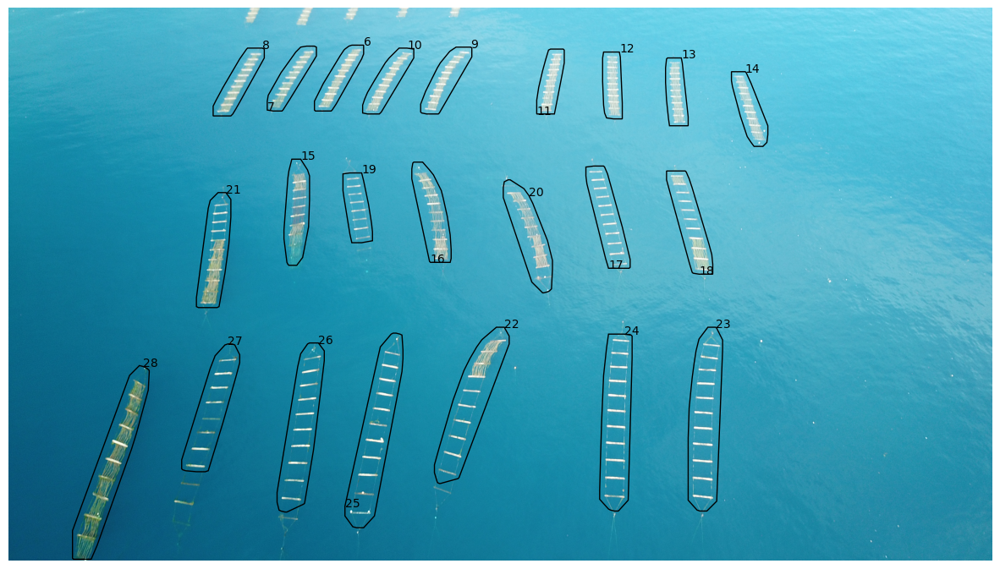

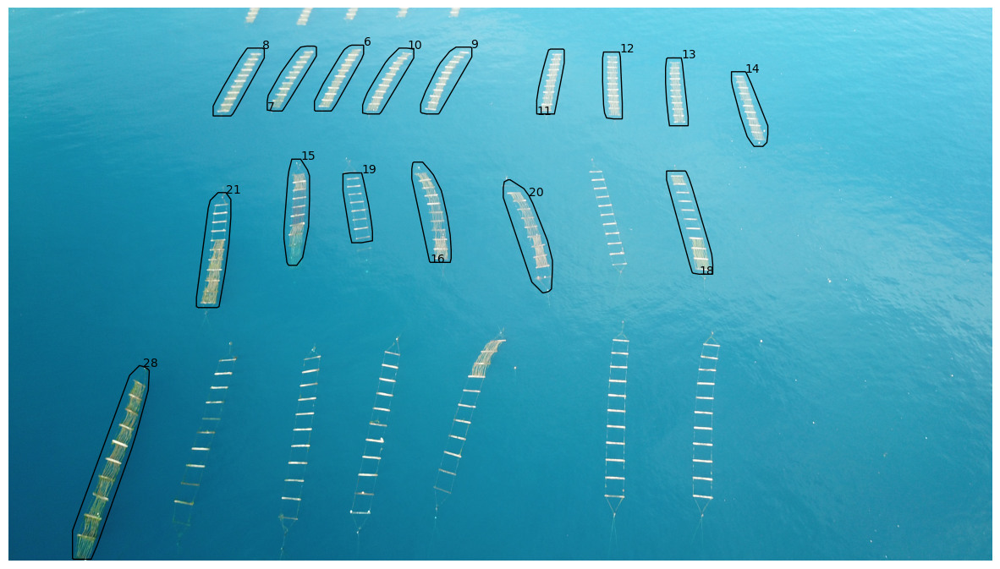

In [7]:
farmGroups = [groupNums[i] for i in range(len(groupNums)) if isFarms[i]]
fullGroups = [groupNums[i] for i in range(len(groupNums)) if isFulls[i]]
imgD.plotRGBImg_GroupsRS(imgrgb,groups,farmGroups,groupVertices,scale,annotate=True)
imgD.plotRGBImg_GroupsRS(imgrgb,groups,fullGroups,groupVertices,scale,annotate=True)

/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/936898887.py:5: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax.fill(groupVertices[groupNum][:,0]/scale,
/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/936898887.py:13: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax.fill(groupVertices[groupNum][:,0]/scale,
/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/936898887.py:18: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ax.fill(groupVertices[groupNum][:,0]/scale,


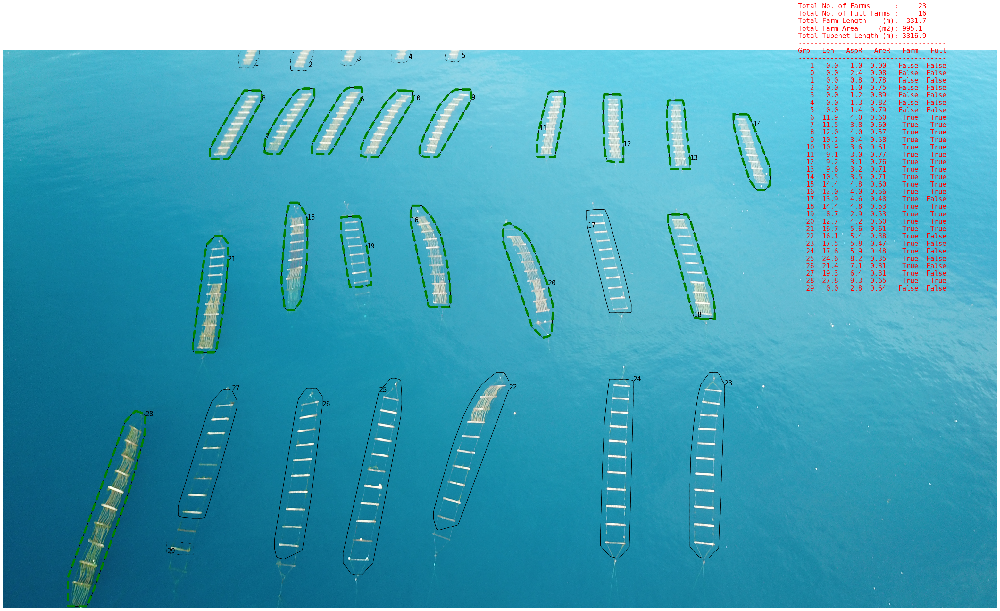

In [8]:
fig, ax = plt.subplots(1,1,figsize=(40,24))
ax.imshow(imgrgb)
ax.axis('off')
for groupNum in groupNums[2:]:
    ax.fill(groupVertices[groupNum][:,0]/scale,
            groupVertices[groupNum][:,1]/scale,
            'k',c='k',linestyle=':',linewidth=1,fill=False)
    ax.annotate(groupNum,xy=(groupVertices[groupNum][-2][0]/scale,
                             groupVertices[groupNum][-2][1]/scale),
                fontsize=15,fontname='monospace',color='k')
    
for groupNum in farmGroups:
    ax.fill(groupVertices[groupNum][:,0]/scale,
            groupVertices[groupNum][:,1]/scale,
            'k',c='k',linestyle='-',linewidth=1,fill=False)

for groupNum in fullGroups:
    ax.fill(groupVertices[groupNum][:,0]/scale,
            groupVertices[groupNum][:,1]/scale,
            'k',c='g',linestyle='--',linewidth=5,fill=False)

txt = ''
txt = txt + 'Total No. of Farms      :     ' + str(len(farmGroups))
txt = txt + '\nTotal No. of Full Farms :     ' + str(len(fullGroups))
txt = txt + '\nTotal Farm Length    (m):  ' + str(round(np.sum(farmLength),1))
txt = txt + '\nTotal Farm Area     (m2): ' + str(round(np.sum(farmArea),1))
txt = txt + '\nTotal Tubenet Length (m): ' + str(round(np.sum(farmTubenet),1))
txt = txt + '\n-------------------------------------'
txt = txt + '\nGrp   Len   AspR   AreR   Farm   Full'
txt = txt + '\n-------------------------------------'
for i in range(len(groupNums)):
    txt = txt + '\n  {0:2d}  {1:4.1f}  {2:4.1f}  {3:3.2f}   {4:>5}  {5:>5}'.format(
        groupNums[i],farmLength[i],aspectRatios[i],
        areaRatios[i],str(isFarms[i]),str(isFulls[i]))
txt = txt + '\n-------------------------------------'

ax.annotate(txt,xy=(3200,1000),fontsize=15,fontname='monospace',color='r')
plt.show()
fig.savefig('Analysis.png')

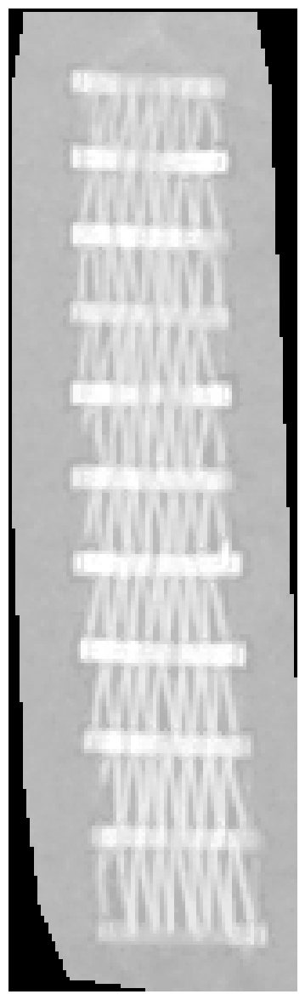

In [9]:
groupNum = 12

#subimg_mask = imgD.getMaskSubImg(img,scale,groupVertices,groupNum)
#subimg_masked = imgD.applyBinMask(img,subimg_mask)
subimg = imgD.getSubImg(img,scale,groupVertices,groupNum)
imgD.plotImg(subimg)

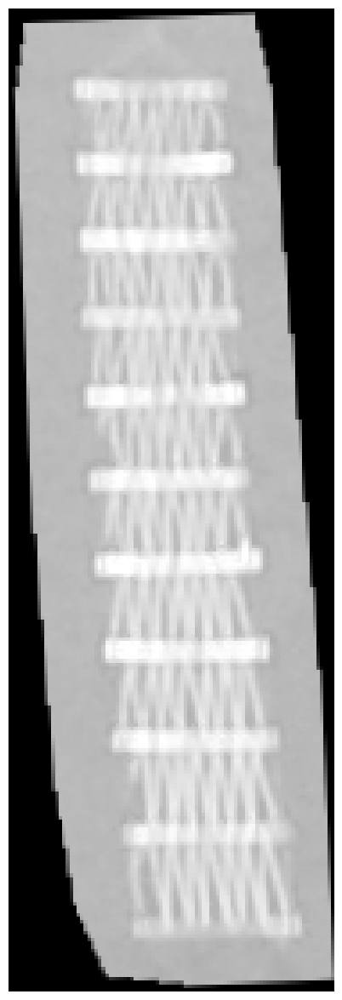

In [10]:
subimg_rot = imgD.rotateSubImg(subimg,
                               plotFit=False,
                               initSigma=1,
                               block_size=101,
                               offset=-0.05,
                               finalSigma=1)
imgD.plotImg(subimg_rot)

/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/3209966163.py:269: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  return np.float(actualArea/imgArea)


0.5125


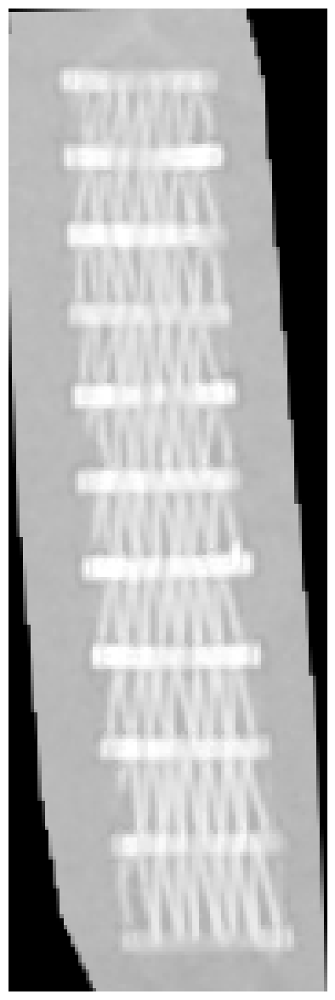

In [11]:
thresh = imgD.determineOptimumThresh_Crop(subimg_rot)
print(thresh)
subimg_rot_crop = imgD.cropSubImg(subimg_rot,sigma=3,thresh=thresh)
imgD.plotImg(subimg_rot_crop)

In [12]:
aspectRatio = imgD.getAspectRatio(subimg_rot_crop)
areaRatio = imgD.getAreaRatio(subimg_rot_crop,
                              initSigma=1,
                              block_size=101,
                              offset=-0.05,
                              finalSigma=1)
sizeRatio = imgD.getSizeRatio(img,subimg_rot_crop)
length = imgD.get_farm_length(subimg_rot_crop)
print(aspectRatio,areaRatio,sizeRatio,length)
isFarm = imgD.check_img_is_farm(subimg_rot_crop)
ifFull = imgD.check_farm_is_full(subimg_rot_crop)
print(isFarm,ifFull)

3.0804597701149423 0.7613655858637846 0.0025906666666666665 9.241379310344827
True True


/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/3209966163.py:255: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  aspectRatio = np.float(img.shape[0]/img.shape[1])
/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/3209966163.py:269: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  return np.float(actualArea/img

In [37]:
#NOTE - FROM HERE - THE ADDITIONAL CODES COMPLIED BY PRANEETH - BEGIN
#LOT OF FUNCTIONS ARE IMPORTED READILY FROM EXISTING CODE

def minimum_bounding_rectangle(temp):
    """
    Find the smallest bounding rectangle for a set of points.
    Returns a set of points representing the corners of the bounding box.

    :param points: an nx2 matrix of coordinates
    :rval: an nx2 matrix of coordinates
    """
    
    import numpy as np
    from scipy.spatial import ConvexHull

    from scipy.ndimage.interpolation import rotate
    pi2 = np.pi/2.

    # get the convex hull for the points
    #hull_points = points[ConvexHull(points).vertices]
    
    hull_points = temp
    
    # calculate edge angles
    edges = np.zeros((len(hull_points)-1, 2))
    edges = hull_points[1:] - hull_points[:-1]

    angles = np.zeros((len(edges)))
    angles = np.arctan2(edges[:, 1], edges[:, 0])

    angles = np.abs(np.mod(angles, pi2))
    angles = np.unique(angles)

    # find rotation matrices
    # XXX both work
    rotations = np.vstack([
        np.cos(angles),
        np.cos(angles-pi2),
        np.cos(angles+pi2),
        np.cos(angles)]).T
#     rotations = np.vstack([
#         np.cos(angles),
#         -np.sin(angles),
#         np.sin(angles),
#         np.cos(angles)]).T
    rotations = rotations.reshape((-1, 2, 2))

    # apply rotations to the hull
    rot_points = np.dot(rotations, hull_points.T)

    # find the bounding points
    min_x = np.nanmin(rot_points[:, 0], axis=1)
    max_x = np.nanmax(rot_points[:, 0], axis=1)
    min_y = np.nanmin(rot_points[:, 1], axis=1)
    max_y = np.nanmax(rot_points[:, 1], axis=1)

    # find the box with the best area
    areas = (max_x - min_x) * (max_y - min_y)
    best_idx = np.argmin(areas)

    # return the best box
    x1 = max_x[best_idx]
    x2 = min_x[best_idx]
    y1 = max_y[best_idx]
    y2 = min_y[best_idx]
    r = rotations[best_idx]

    rval = np.zeros((4, 2))
    rval[0] = np.dot([x1, y2], r)
    rval[1] = np.dot([x2, y2], r)
    rval[2] = np.dot([x2, y1], r)
    rval[3] = np.dot([x1, y1], r)

    rval2 = np.array(rval, np.int32)
    return(rval2)



def polygon_area(x1,y1):
    
    #computes the area of a polygon given the coordinates of the polygon
    
    # coordinate shift
    x = np.array(x1)
    y = np.array(y1)
    x_ = x - x.mean()
    y_ = y - y.mean()
    # everything else is the same as maxb's code
    correction = x_[-1] * y_[0] - y_[-1]* x_[0]
    main_area = np.dot(x_[:-1], y_[1:]) - np.dot(y_[:-1], x_[1:])
    return 0.5*np.abs(main_area + correction)




def max_index_compute(temp):
    #given an input of convex hull points - this function outputs the collection of 4 points
    #which are the set of points of the quadrilateral - which are the best representative
    #of a large cluster of points
        
        
    cvX = temp[:,0]
    cvY = temp[:,1]

    numberOfPoints = len(cvX)
    maxArea = 0;
    
    for k1 in range(numberOfPoints):
      for k2 in range(numberOfPoints):
        for k3 in range(numberOfPoints):
          for k4 in range(numberOfPoints):
                    verticesX = [cvX[k1], cvX[k2], cvX[k3], cvX[k4]]
                    verticesY = [cvY[k1], cvY[k2], cvY[k3], cvY[k4]]
                    #thisArea = PolyArea(verticesX, verticesY)
                    thisArea = polygon_area(verticesX, verticesY)
                    if thisArea > maxArea:
                      maxArea = thisArea
                      indexesAtmax = [k1, k2, k3, k4]
    
    op = temp[indexesAtmax]
    return(op)



def order_points(pts):
    
    #given an input of four points, this function returns the points ordered in a clockwise
    #manner
    
    from scipy.spatial import distance as dist
    import numpy as np
    import cv2
    import scipy
    
    # sort the points based on their x-coordinates
    xSorted = pts[np.argsort(pts[:, 0]), :]

    # grab the left-most and right-most points from the sorted
    # x-roodinate points
    leftMost = xSorted[:2, :]
    rightMost = xSorted[2:, :]

    # now, sort the left-most coordinates according to their
    # y-coordinates so we can grab the top-left and bottom-left
    # points, respectively
    leftMost = leftMost[np.argsort(leftMost[:, 1]), :]
    (tl, bl) = leftMost

    # now that we have the top-left coordinate, use it as an
    # anchor to calculate the Euclidean distance between the
    # top-left and right-most points; by the Pythagorean
    # theorem, the point with the largest distance will be
    # our bottom-right point
    D = dist.cdist(tl[np.newaxis], rightMost, "euclidean")[0]
    (br, tr) = rightMost[np.argsort(D)[::-1], :]

    # return the coordinates in top-left, top-right,
    # bottom-right, and bottom-left order
    return np.array([tl, tr, br, bl], dtype="float32")



def asp_ratio(img, ordered_points_int, center_coordinates):
    
    #This function is adapted from 
    #https://www.microsoft.com/en-us/research/publication/whiteboard-scanning-image-enhancement/?from=http%3A%2F%2Fresearch.microsoft.com%2Fen-us%2Fum%2Fpeople%2Fzhang%2Fpapers%2Ftr03-39.pdf
    #assuming a pinhole camera model, it is possible to calculate the aspect ratio for a projected rectangle (but not the scale, unsurprisingly). Essentially, one can solve for the focal length, then get the aspect ratio
    
    #the problem with this method is 1/0 error in focal length occurs at times causing blowing up
    #moreover the aspect ratios which are output are quite varied
    #the pinhole model does not work for this case.
    
    import math
    import scipy
    from scipy.spatial import distance as dist
    import numpy as np
    import cv2

    coordA = ordered_points_int[0]
    coordB = ordered_points_int[1]
    coordC= ordered_points_int[3]
    coordD= ordered_points_int[2]
    
    p = (coordA, coordB, coordC, coordD)
    
    v0 = center_coordinates[1]
    u0 = center_coordinates[0]
    
    
    #detected corners on the original image
    
    #widths and heights of the projected image
    w1 = scipy.spatial.distance.euclidean(p[0],p[1])
    w2 = scipy.spatial.distance.euclidean(p[2],p[3])
    
    h1 = scipy.spatial.distance.euclidean(p[0],p[2])
    h2 = scipy.spatial.distance.euclidean(p[1],p[3])
    
    w = max(w1,w2)
    h = max(h1,h2)
    
    #visible aspect ratio
    ar_vis = float(w)/float(h)
    
    #make numpy arrays and append 1 for linear algebra
    m1 = np.array((p[0][0],p[0][1],1)).astype('float32')
    m2 = np.array((p[1][0],p[1][1],1)).astype('float32')
    m3 = np.array((p[2][0],p[2][1],1)).astype('float32')
    m4 = np.array((p[3][0],p[3][1],1)).astype('float32')
    
    #calculate the focal disrance
    k2 = np.dot(np.cross(m1,m4),m3) / np.dot(np.cross(m2,m4),m3)
    k3 = np.dot(np.cross(m1,m4),m2) / np.dot(np.cross(m3,m4),m2)
    
    n2 = k2 * m2 - m1
    n3 = k3 * m3 - m1
    
    n21 = n2[0]
    n22 = n2[1]
    n23 = n2[2]
    
    n31 = n3[0]
    n32 = n3[1]
    n33 = n3[2]
    
    f = math.sqrt(np.abs( (1.0/(n23*n33)) * ((n21*n31 - (n21*n33 + n23*n31)*u0 + n23*n33*u0*u0) + (n22*n32 - (n22*n33+n23*n32)*v0 + n23*n33*v0*v0))))
    
    A = np.array([[f,0,u0],[0,f,v0],[0,0,1]]).astype('float32')
    
    At = np.transpose(A)
    Ati = np.linalg.inv(At)
    Ai = np.linalg.inv(A)
    
    #calculate the real aspect ratio
    ar_real = math.sqrt(np.dot(np.dot(np.dot(n2,Ati),Ai),n2)/np.dot(np.dot(np.dot(n3,Ati),Ai),n3))
    
    if ar_real < ar_vis:
        try:
            W = int(w)
            H = int(W / ar_real)
        except:
            H = 1
    else:
        H = int(h)
        W = int(ar_real * H)
    
    pts1 = np.array(p).astype('float32')
    pts2 = np.float32([[0,0],[W,0],[0,H],[W,H]])
    
    #project the image with the new w/h
    M = cv2.getPerspectiveTransform(pts1,pts2)
    dst = cv2.warpPerspective(img,M,(W,H))
    #plt.imshow(dst)
    
    #cv2.imwrite('orig.png',img)
    #cv2.imwrite('proj.png',dst)
    
    #print(f)
    
    return(ar_real,dst)

def asp_ratio_simpler(img, ordered_points_int):

    #this is a straightforward method to apply warping - not much of brain is used as far as the aspect ratio is concerned
    #aspect ratio is not accurately computed
    
    
    import math
    import scipy
    from scipy.spatial import distance as dist
    import numpy as np
    import cv2

    (tl, tr, br, bl) = ordered_points_int
    widthA = np.sqrt(((br[0] - bl[0]) ** 2) + ((br[1] - bl[1]) ** 2))
    widthB = np.sqrt(((tr[0] - tl[0]) ** 2) + ((tr[1] - tl[1]) ** 2))
    # ...and now for the height of our new image
    heightA = np.sqrt(((tr[0] - br[0]) ** 2) + ((tr[1] - br[1]) ** 2))
    heightB = np.sqrt(((tl[0] - bl[0]) ** 2) + ((tl[1] - bl[1]) ** 2))
    # take the maximum of the width and height values to reach
    # our final dimensions
    
    maxWidth = max(int(widthA), int(widthB))
    maxHeight = max(int(heightA), int(heightB))
    # construct our destination points which will be used to
      
    orig_new = np.array([ordered_points_int[0], ordered_points_int[1], ordered_points_int[3], ordered_points_int[2]],dtype = "float32" )
    dst_new = np.array([	[0, 0], [maxWidth - 1, 0], [0, maxHeight - 1], [maxWidth - 1, maxHeight - 1]], dtype = "float32")

    M = cv2.getPerspectiveTransform(orig_new, dst_new)
        
    warp = cv2.warpPerspective(img, M, (maxWidth, maxHeight))
    as_ratio = maxWidth/maxHeight
    
    return(as_ratio, warp)
    
 


In [15]:
#Experimenting - with these stuff    

def plotRGBImg_GroupsRS(self,rgbimg,groups,groupNums,groupVertices,scale,
                        fmt='k-',linewidth=1,annotate=True):
    fig, ax = plt.subplots(1,1,figsize=(15, 15))
    ax.axis('off')
    ax.imshow(rgbimg)
    for groupNum in groupNums:
        ax.fill(groupVertices[groupNum][:,0]/scale,
                groupVertices[groupNum][:,1]/scale,
                fmt,linewidth=linewidth,fill=False)
        if annotate:
            ax.annotate(groupNum,xy=(groupVertices[groupNum][0][0]/scale,
                                     groupVertices[groupNum][0][1]/scale))
    plt.show()        





In [16]:
def plotImg_ann(self,img,title=None,cmap='gray',figsize=(15,15)):
    fig, ax = plt.subplots(1,1,figsize=figsize)
    ax.axis('off')
    ax.imshow(img,cmap=cmap)
    if title:
        ax.set_title(title,fontsize=20)
    
    
    ax.annotate(groupNum,xy=(groupVertices[groupNum][0][0]/scale,
                                         groupVertices[groupNum][0][1]/scale))
    plt.show()



In [17]:
#SCALING UP BY 4.0

gvx = []

for i in range(len(groupVertices)):
    gvx.append(max(groupVertices[i][:,0]))    
gvy = []
for i in range(len(groupVertices)):
    gvy.append(max(groupVertices[i][:,1]))

gvx_max = max(gvx)
gvy_max = max(gvy)

groupVertices2 = groupVertices.copy()
for i in range(len(groupVertices2)):
    groupVertices2[i] = groupVertices2[i]*4
  

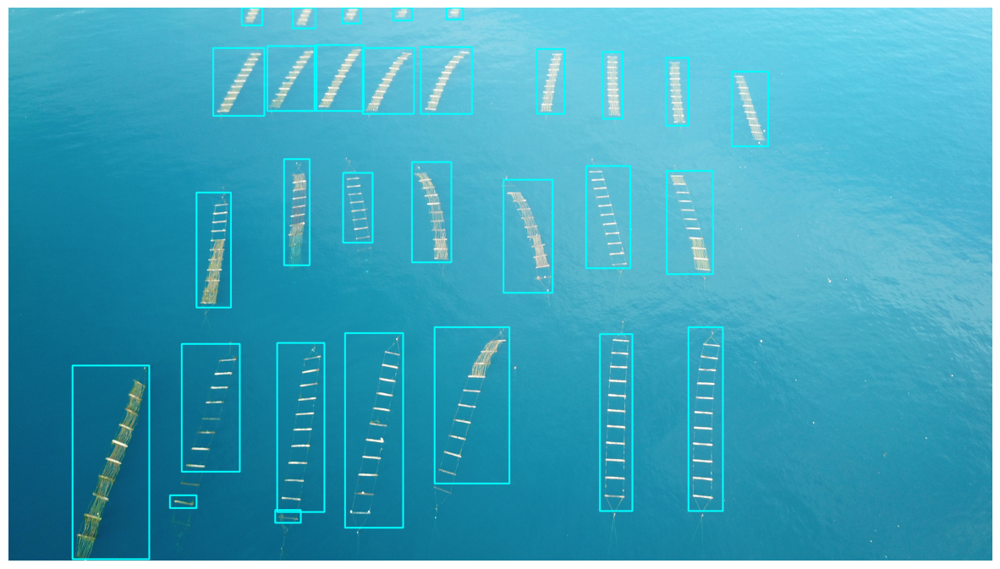

In [18]:
#conversion of convex hull into RECTANGLES

rect_overall = []
centres_overall = []

#this is forcing everything to be a rectangle - not a quadrangle
for i in range(len(groupVertices2)):
    temp = groupVertices2[i]
    coord1min = min(temp[:,0])
    coord1max = max(temp[:,0])
    coord2min = min(temp[:,1])
    coord2max = max(temp[:,1])
    
    a = [coord1min, coord2min]
    c = [coord1max, coord2min]
    d = [coord1max, coord2max]
    b = [coord1min, coord2max]
    
    four_points = [a,c,d,b]
    rect_overall.append(four_points)
    centre_x = 0.5*(coord1min + coord1max)
    centre_y = 0.5*(coord2min + coord2max)
    centre_xy = [centre_x, centre_y]
    centres_overall.append(centre_xy)

color = (0, 255, 255) 
thickness = 5
isClosed = True

img1_rectangle = imgrgb
img2_rectangle = img1_rectangle.copy()


for i in range(1, len(rect_overall)):
    temp = np.array(rect_overall[i], np.int32)
    img2_rectangle = cv2.polylines(img2_rectangle, [temp], isClosed, color, thickness) 

imgD.plotImg(img2_rectangle)


/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/1385530811.py:16: DeprecationWarning: Please use `rotate` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  from scipy.ndimage.interpolation import rotate


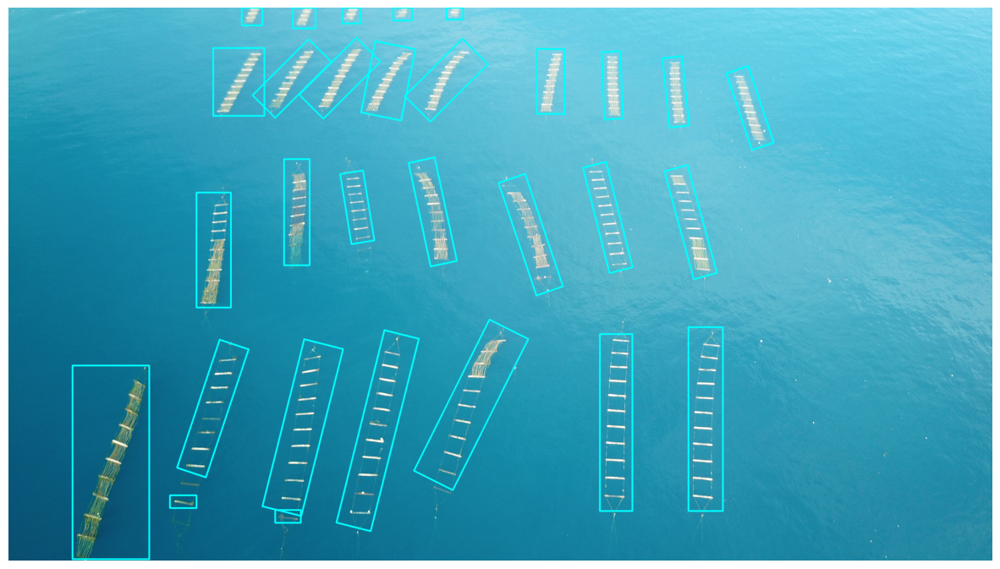

In [21]:
#CONVERSION TO BOUNDING RECTANGLES


color = (0, 255, 255) 
thickness = 5
isClosed = True

img1_min_bounding_rectangle = imgrgb
img2_min_bounding_rectangle = img1_min_bounding_rectangle.copy()


for i in range(1, len(groupVertices2)):
    temp = groupVertices2[i]
    rval2 = minimum_bounding_rectangle(temp)
    img2 = cv2.polylines(img2_min_bounding_rectangle, [rval2], isClosed, color, thickness) 

imgD.plotImg(img2_min_bounding_rectangle)


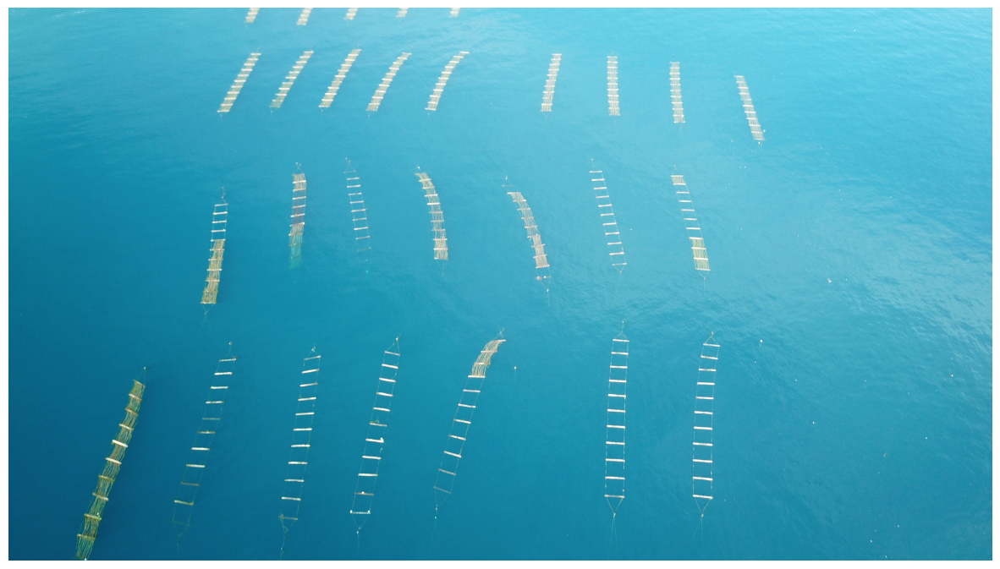

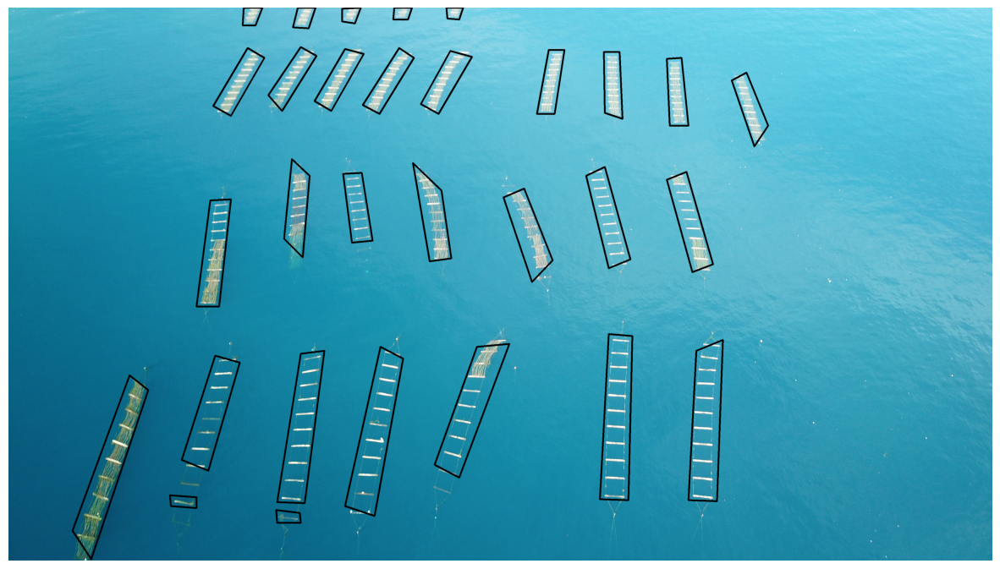

In [22]:
#Note, the set of ellipse-like points detected by the convex hull have to be converted to a quadrilateral
#also called quadrangle - so as to facilitate the next step - which is the Perspective Transformation
#the perspective transformation is the next step - which is going to be done subsequently 

color = (0, 0, 0) 
thickness = 5
isClosed = True

img1_quadrangle = imgrgb
img2_quadrangle = img1_quadrangle.copy()



#slightly computationally intensive
#because of the MATLAB code which was implemented

for i in np.arange(1,len(groupVertices2)):
    temp = groupVertices2[i]
    index_max_op = max_index_compute(temp)
    img2_quadrangle = cv2.polylines(img2_quadrangle, [index_max_op], isClosed, color, thickness) 


imgD.plotImg(img1_quadrangle)
    
imgD.plotImg(img2_quadrangle)

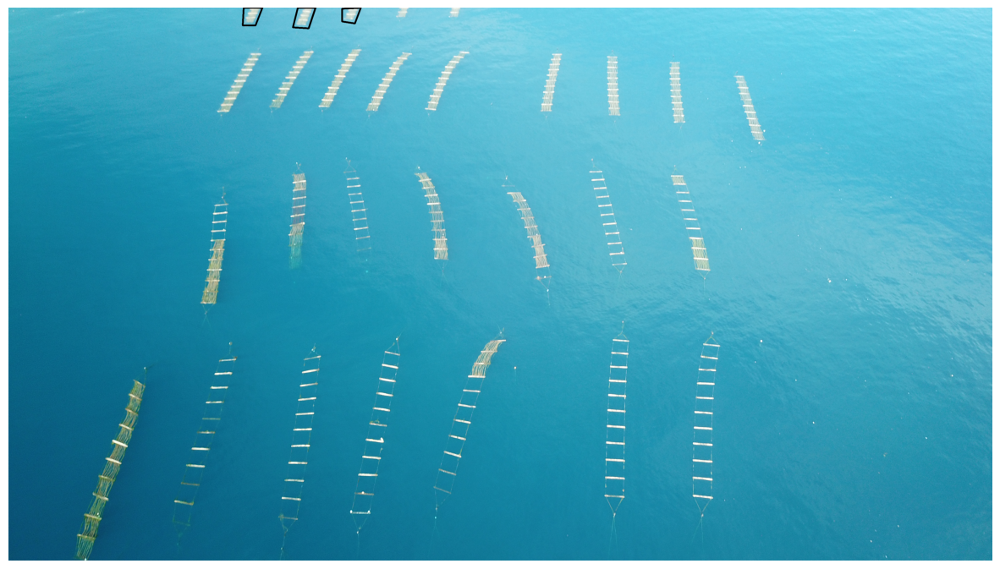

In [23]:
#A rough estimate of the centre of the quadrangles is computed using the rectangles computed
#The coordinates of the centre are important to be used for one particular Perspective transform algo

index_max_values = [max_index_compute(elem) for elem in groupVertices2]

index_max_except0 = index_max_values[1:]

co_array = np.array(centres_overall, np.int32)
co_array_except0 = co_array[1:]

V0 = co_array_except0[:,0]
U0 = co_array_except0[:,1]


color = (0, 0, 0) 
thickness_poly = 5
isClosed = True

img1_quadrangle = imgrgb
img2_quadrangle = img1_quadrangle.copy()



# Radius of circle 
radius = 25   
# Blue color in BGR 
color = (0, 0, 0)    
# Line thickness of 2 px 
thickness_circle = -1

#to check whether the centre of the
#rectangle lies with in the quadrangle

img1_cq = imgrgb
img2_cq = img1_cq.copy()

#for i in range(len(co_array_except0)):
for i in range(3):
    temp = index_max_except0[i]
    img2_cq = cv2.polylines(img2_cq, [temp], isClosed, color, thickness_poly) 
    center_coordinates = tuple(co_array_except0[i])
    try:
        #img2_cq = cv2.circle(img2_cq, center_coordinates, radius, color, thickness_circle)
        img2_cq = cv2.putText(image, str(i+1), center_coordinates, cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36,255,12), 30)


    except:
        pass
    

imgD.plotImg(img2_cq)


/var/folders/fc/mjdjhyc14l1fg9j0fbzhj0_00000gn/T/ipykernel_28713/2573040675.py:226: RuntimeWarning: divide by zero encountered in true_divide
  f = math.sqrt(np.abs( (1.0/(n23*n33)) * ((n21*n31 - (n21*n33 + n23*n31)*u0 + n23*n33*u0*u0) + (n22*n32 - (n22*n33+n23*n32)*v0 + n23*n33*v0*v0))))


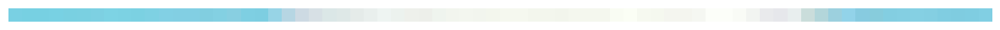

In [39]:
#warping using LINAL algo using sophisticated focal length & estimation of aspect ratio

aval_overall = []
dst_images = []
#dst_images contains all the outputs of the warped images

img = img2_quadrangle

for i in range(0, len(index_max_except0)):
    center_coordinates = tuple(co_array_except0[i])
    ordered_points = order_points(index_max_except0[i])
    ordered_points_int = np.int32(ordered_points)
    aval = asp_ratio(img, ordered_points_int, center_coordinates)[0]
    aval_overall.append(aval)
    dst= asp_ratio(img, ordered_points_int, center_coordinates)[1]
    dst_images.append(dst)
    


imgD.plotImg(dst_images[3])

#The printed values are the values of the focal length - focal length is not intended to be outputed by the algorithm
#but the focal length is computed automatically by the algorithm

In [41]:
#warping using simple algo
#dst_images_simpler records all the outputs of the warped seaweed farms

aval_overall_simpler = []
dst_images_simpler = []
img = img2_quadrangle

for i in range(0, len(index_max_except0)):
    ordered_points = order_points(index_max_except0[i])
    ordered_points_int = np.int32(ordered_points)
    aval = asp_ratio_simpler(img, ordered_points_int)[0]
    aval_overall_simpler.append(aval)
    dst = asp_ratio_simpler(img, ordered_points_int)[1]
    dst_images_simpler.append(dst)


aspect_ratio_simpler = [max(elem,1/elem) for elem in aval_overall_simpler]
    

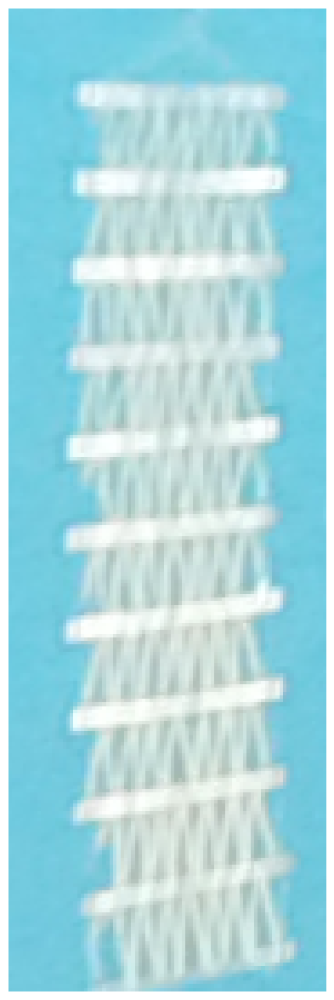

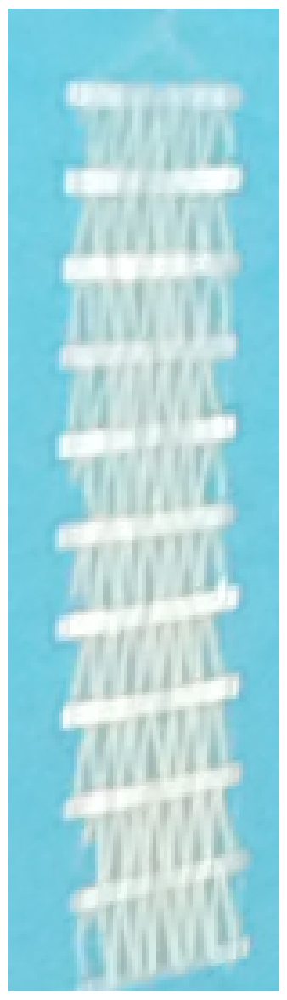

In [42]:
#figure with the aspect_ratio_focal_length algo

#for one particular seaweed farm
imgD.plotImg(dst_images[11])


#figure with the simpler aspect ratio algo

imgD.plotImg(dst_images_simpler[11])


In [43]:
#comparison of aspect ratios of two algorithms (all aspect ratios are made>1)

aspect_ratio = [max(elem,1/elem) if elem!=0 else 0 for elem in aval_overall]

aspect_ratio_simpler = [max(elem,1/elem) for elem in aval_overall_simpler]

In [44]:
import pandas as pd

data_tuples = list(zip(aspect_ratio,aspect_ratio_simpler))

aspect_ratio = pd.DataFrame(data_tuples, columns=['Algo 1','Algo 2'])  

print(aspect_ratio)


      Algo 1    Algo 2
0   0.000000  1.013158
1   1.373189  1.222222
2   1.007297  1.117647
3   0.000000  1.440000
4   1.053662  1.360000
5   2.371102  3.410256
6   2.790707  3.105882
7   3.411795  3.341463
8   2.504374  2.945055
9   3.606381  3.618421
10  0.000000  3.666667
11  3.065247  3.626667
12  4.342461  3.644737
13  2.315485  2.830000
14  3.836488  3.112150
15  1.024717  2.515528
16  4.953755  4.105263
17  4.890527  4.393258
18  3.754365  3.357143
19  2.669666  3.000000
20  5.449046  4.760870
21  2.902713  4.393939
22  3.868032  5.655172
23  6.600483  5.793103
24  1.674748  5.460317
25  6.062118  5.580357
26  4.106398  3.948276
27  2.892792  5.536232
28  1.499435  2.454545
29  3.528731  1.846154
